# Charlottesville Residential Single Family Real Estate Analysis

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import folium
import string
from folium import plugins
%matplotlib inline
import locale 
from locale import atof
#locale.setlocale(locale.LC_ALL, 'en_US.UTF8')

sns.set()
plt.rcParams["figure.figsize"] = (15,7)

In [2]:
sf_data=pd.read_csv('csv/ResidentialSingleFamily.csv')
sf_data

/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (4,10,19,20,22) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,SaleDate,RecordID_Int,ParcelNumber,SaleAmount,Unit,Address1,RecordID_Int.1,ParcelNumber.1,StreetNumber,StreetName,...,FullBathrooms,BasementGarage,Basement,FinishedBasement,BasementType,ExternalWalls,NumberOfStories,SquareFootageFinishedLiving,Latitude,Longitude
0,2003-01-31 00:00:00+00:00,61,010006000,545000,NaN,2028 BARRACKS RD,3.0,010006000,2028,BARRACKS RD,...,4,0,1018.0,900.0,Partial Basement,Brick Veneer,2.00,3368.0,38.050765,-78.498080
1,1982-07-27 00:00:00+00:00,62,010007000,160000,NaN,1930 BARRACKS RD,4.0,010007000,1930,BARRACKS RD,...,4,0,1708.0,1468.0,Partial Basement,Brick Veneer,2.00,5446.0,38.050395,-78.497636
2,1984-08-31 00:00:00+00:00,65,010009000,175000,NaN,1920 BARRACKS RD,6.0,010009000,1920,BARRACKS RD,...,3,0,1128.0,NaN,Full Basement,Brick Veneer,2.00,2633.0,38.049731,-78.497104
3,2018-10-31 00:00:00+00:00,67,010010000,575000,NaN,1851 WESTVIEW RD,7.0,010010000,1851,WESTVIEW RD,...,3,0,1153.0,790.0,Full Basement,Concrete Block,1.25,1441.0,38.048508,-78.498668
4,2018-01-10 00:00:00+00:00,69,010011000,970000,NaN,1855 WESTVIEW RD,8.0,010011000,1855,WESTVIEW RD,...,5,1,2492.0,1573.0,Full Basement,Brick Veneer,1.33,3392.0,38.049037,-78.498346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20211,1993-02-11 00:00:00+00:00,55632,610104000,56569,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
20212,1993-07-07 00:00:00+00:00,55633,610104000,69800,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
20213,2009-10-05 00:00:00+00:00,55634,610104000,220000,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
20214,2018-12-14 00:00:00+00:00,55635,610104000,307500,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197


In [3]:
sf_data['SaleDate']=pd.to_datetime(sf_data['SaleDate'])
sf_data=sf_data.set_index(['SaleDate'])
sf_data

,RecordID_Int,ParcelNumber,SaleAmount,Unit,Address1,RecordID_Int.1,ParcelNumber.1,StreetNumber,StreetName,Unit.1,...,FullBathrooms,BasementGarage,Basement,FinishedBasement,BasementType,ExternalWalls,NumberOfStories,SquareFootageFinishedLiving,Latitude,Longitude
SaleDate,,,,,,,,,,,,,,,,,,,,,
2003-01-31 00:00:00+00:00,61,010006000,545000,NaN,2028 BARRACKS RD,3.0,010006000,2028,BARRACKS RD,NaN,...,4,0,1018.0,900.0,Partial Basement,Brick Veneer,2.00,3368.0,38.050765,-78.498080
1982-07-27 00:00:00+00:00,62,010007000,160000,NaN,1930 BARRACKS RD,4.0,010007000,1930,BARRACKS RD,NaN,...,4,0,1708.0,1468.0,Partial Basement,Brick Veneer,2.00,5446.0,38.050395,-78.497636
1984-08-31 00:00:00+00:00,65,010009000,175000,NaN,1920 BARRACKS RD,6.0,010009000,1920,BARRACKS RD,NaN,...,3,0,1128.0,NaN,Full Basement,Brick Veneer,2.00,2633.0,38.049731,-78.497104
2018-10-31 00:00:00+00:00,67,010010000,575000,NaN,1851 WESTVIEW RD,7.0,010010000,1851,WESTVIEW RD,NaN,...,3,0,1153.0,790.0,Full Basement,Concrete Block,1.25,1441.0,38.048508,-78.498668
2018-01-10 00:00:00+00:00,69,010011000,970000,NaN,1855 WESTVIEW RD,8.0,010011000,1855,WESTVIEW RD,NaN,...,5,1,2492.0,1573.0,Full Basement,Brick Veneer,1.33,3392.0,38.049037,-78.498346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1993-02-11 00:00:00+00:00,55632,610104000,56569,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,NaN,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
1993-07-07 00:00:00+00:00,55633,610104000,69800,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,NaN,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
2009-10-05 00:00:00+00:00,55634,610104000,220000,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,NaN,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197


In [4]:
sf20_data=sf_data.loc['2000-06-05':'2020-06-05']
sf20_data.shape

(10163, 31)

In [5]:
sf20_data.to_csv('csv/SingleFamily20yrs.csv')

# Folium Map with Markers

In [6]:
def generateBaseMap(default_location=[38.051004,-78.505250], default_zoom_start=12):
    base_map=folium.Map(location=default_location, control_scale=True,zoom_start=default_zoom_start)
    return base_map

In [7]:
def plotIt(df):
    #map1=generateBaseMap()
    folium.CircleMarker(location=[df.Latitude, df.Longitude], radius = 2, popup=str(df.Address1)+'\nSaleAmount: $'+'{:,.2f}'.format(df.SaleAmount), fill=False).add_to(map1)

In [8]:
def plot(df):
    #map1=generateBaseMap()
    for index, row in sf20_data.iterrows():
        popup_text=str(row['Address1'])+'\nSaleAmount: $'+'{:,.2f}'.format(row['SaleAmount'])
        if row['SaleAmount']<100000:
            color='#FFFF00'
        elif row['SaleAmount']>100000 and row['SaleAmount']<200000:
            color='#FF8000'
        elif row['SaleAmount']>200000 and row['SaleAmount']<500000:
            color='#FF0000' 
        else:
            color = '#8B0000'
        folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius = 2, color = color, popup=popup_text, fill=False).add_to(map1)


In [9]:
def plot_g(df):    
    fg=folium.FeatureGroup(name='All Sales')
    m2.add_child(fg)
    
    g1 = plugins.FeatureGroupSubGroup(fg, '<$100,000')
    m2.add_child(g1)

    g2 = plugins.FeatureGroupSubGroup(fg, '$100,000-$200,000')
    m2.add_child(g2)
    
    g3 = plugins.FeatureGroupSubGroup(fg, '$200,000-$350,000')
    m2.add_child(g3)
    
    g6 = plugins.FeatureGroupSubGroup(fg, '$350,000-$500,000')
    m2.add_child(g6)

    g4 = plugins.FeatureGroupSubGroup(fg, '$500,000-$1,000,000')
    m2.add_child(g4)
    
    g5 = plugins.FeatureGroupSubGroup(fg, '>$1,000,000')
    m2.add_child(g5)

    for index, row in sf20_data.iterrows():
        popup_text=str(row['Address1'])+'\nSaleAmount: $'+'{:,.2f}'.format(row['SaleAmount'])
        if row['SaleAmount']<100000:
            color='#FEF001'
            group=g1
        elif row['SaleAmount']>100000 and row['SaleAmount']<200000:
            color='#FD9A01'
            group=g2
        elif row['SaleAmount']>200000 and row['SaleAmount']<350000:
            color='#orangered' 
            group=g3
        elif row['SaleAmount']>350000 and row['SaleAmount']<500000:
            color='#FF0000' 
            group=g3
        elif row['SaleAmount']>500000 and row['SaleAmount']<1000000:
            color='#B22222' 
            group=g4
        else:
            color = '#800000'
            group=g5
        folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius = 2, color = color, popup=popup_text, fill=False,line_opacity=0.5).add_to(group)
        
    folium.LayerControl(collapsed=False).add_to(m2)

Folium Markers grouped by Sale Amount

In [10]:
m2=generateBaseMap()
plot_g(sf20_data)
m2.save('html/colors_groups2.html')
m2

Colors represent sale amount. No grouping for markers.

In [14]:
map1=generateBaseMap()
plot(sf20_data)
map1.save('html/colorplot.html')
map1

# Folium Heatmap Attempt

In [15]:
sf_heatmap = pd.read_csv('csv/ResidentialSingleFamily.csv')
sf_heatmap

/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (4,10,19,20,22) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,SaleDate,RecordID_Int,ParcelNumber,SaleAmount,Unit,Address1,RecordID_Int.1,ParcelNumber.1,StreetNumber,StreetName,...,FullBathrooms,BasementGarage,Basement,FinishedBasement,BasementType,ExternalWalls,NumberOfStories,SquareFootageFinishedLiving,Latitude,Longitude
0,2003-01-31 00:00:00+00:00,61,010006000,545000,NaN,2028 BARRACKS RD,3.0,010006000,2028,BARRACKS RD,...,4,0,1018.0,900.0,Partial Basement,Brick Veneer,2.00,3368.0,38.050765,-78.498080
1,1982-07-27 00:00:00+00:00,62,010007000,160000,NaN,1930 BARRACKS RD,4.0,010007000,1930,BARRACKS RD,...,4,0,1708.0,1468.0,Partial Basement,Brick Veneer,2.00,5446.0,38.050395,-78.497636
2,1984-08-31 00:00:00+00:00,65,010009000,175000,NaN,1920 BARRACKS RD,6.0,010009000,1920,BARRACKS RD,...,3,0,1128.0,NaN,Full Basement,Brick Veneer,2.00,2633.0,38.049731,-78.497104
3,2018-10-31 00:00:00+00:00,67,010010000,575000,NaN,1851 WESTVIEW RD,7.0,010010000,1851,WESTVIEW RD,...,3,0,1153.0,790.0,Full Basement,Concrete Block,1.25,1441.0,38.048508,-78.498668
4,2018-01-10 00:00:00+00:00,69,010011000,970000,NaN,1855 WESTVIEW RD,8.0,010011000,1855,WESTVIEW RD,...,5,1,2492.0,1573.0,Full Basement,Brick Veneer,1.33,3392.0,38.049037,-78.498346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20211,1993-02-11 00:00:00+00:00,55632,610104000,56569,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
20212,1993-07-07 00:00:00+00:00,55633,610104000,69800,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
20213,2009-10-05 00:00:00+00:00,55634,610104000,220000,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197
20214,2018-12-14 00:00:00+00:00,55635,610104000,307500,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197


In [16]:
sf_heatmap = sf_heatmap[['SaleDate','SaleAmount', 'Latitude','Longitude']].copy()

In [17]:
sf_heatmap

,SaleDate,SaleAmount,Latitude,Longitude
0,2003-01-31 00:00:00+00:00,545000,38.050765,-78.498080
1,1982-07-27 00:00:00+00:00,160000,38.050395,-78.497636
2,1984-08-31 00:00:00+00:00,175000,38.049731,-78.497104
3,2018-10-31 00:00:00+00:00,575000,38.048508,-78.498668
4,2018-01-10 00:00:00+00:00,970000,38.049037,-78.498346
...,...,...,...,...
20211,1993-02-11 00:00:00+00:00,56569,38.014544,-78.472197
20212,1993-07-07 00:00:00+00:00,69800,38.014544,-78.472197
20213,2009-10-05 00:00:00+00:00,220000,38.014544,-78.472197
20214,2018-12-14 00:00:00+00:00,307500,38.014544,-78.472197


# Folium TimeStampedGeoJson 

In [21]:
sf20_data['SaleDate']=sf20_data.index

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [22]:
sf20_data=sf20_data.drop(columns=['SaleDate'])
sf20_data

,RecordID_Int,ParcelNumber,SaleAmount,Unit,Address1,RecordID_Int.1,ParcelNumber.1,StreetNumber,StreetName,Unit.1,...,FullBathrooms,BasementGarage,Basement,FinishedBasement,BasementType,ExternalWalls,NumberOfStories,SquareFootageFinishedLiving,Latitude,Longitude
SaleDate,,,,,,,,,,,,,,,,,,,,,
2003-01-31 00:00:00+00:00,61,010006000,545000,NaN,2028 BARRACKS RD,3.0,010006000,2028,BARRACKS RD,NaN,...,4,0,1018.0,900.0,Partial Basement,Brick Veneer,2.00,3368.0,38.050765,-78.498080
2018-10-31 00:00:00+00:00,67,010010000,575000,NaN,1851 WESTVIEW RD,7.0,010010000,1851,WESTVIEW RD,NaN,...,3,0,1153.0,790.0,Full Basement,Concrete Block,1.25,1441.0,38.048508,-78.498668
2018-01-10 00:00:00+00:00,69,010011000,970000,NaN,1855 WESTVIEW RD,8.0,010011000,1855,WESTVIEW RD,NaN,...,5,1,2492.0,1573.0,Full Basement,Brick Veneer,1.33,3392.0,38.049037,-78.498346
2015-05-04 00:00:00+00:00,73,010012000,512000,NaN,1857 WESTVIEW RD,9.0,010012000,1857,WESTVIEW RD,NaN,...,2,0,252.0,NaN,Full Basement,Brick Veneer,2.00,2235.0,38.049108,-78.499057
2007-06-26 00:00:00+00:00,78,010014000,975000,NaN,1885 WESTVIEW RD,10.0,010014000,1885,WESTVIEW RD,NaN,...,4,0,1671.0,1330.0,Partial Basement,Brick/Masonry,1.50,2584.0,38.049347,-78.499412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2004-01-15 00:00:00+00:00,55602,610094000,120000,NaN,802 NASSAU ST,14543.0,610094000,802,NASSAU ST,NaN,...,1,0,NaN,NaN,No Basement,Vinyl,1.00,1045.0,38.018323,-78.467491
2008-01-08 00:00:00+00:00,55603,610094000,242000,NaN,802 NASSAU ST,14543.0,610094000,802,NASSAU ST,NaN,...,1,0,NaN,NaN,No Basement,Vinyl,1.00,1045.0,38.018323,-78.467491
2019-08-02 00:00:00+00:00,55625,610101000,160000,NaN,1307 MOUNTAIN VIEW ST,14551.0,610101000,1307,MOUNTAIN VIEW ST,NaN,...,1,0,NaN,NaN,No Basement,Wood,1.50,1008.0,38.014193,-78.472775


In [23]:
sf20_data=sf20_data.reset_index()

In [24]:
sf20_data['SaleDate']=sf20_data['SaleDate'].astype(str)

In [25]:
sf20_data['SaleDate']=sf20_data['SaleDate'].str[0:10]
sf20_data

,SaleDate,RecordID_Int,ParcelNumber,SaleAmount,Unit,Address1,RecordID_Int.1,ParcelNumber.1,StreetNumber,StreetName,...,FullBathrooms,BasementGarage,Basement,FinishedBasement,BasementType,ExternalWalls,NumberOfStories,SquareFootageFinishedLiving,Latitude,Longitude
0,2003-01-31,61,010006000,545000,NaN,2028 BARRACKS RD,3.0,010006000,2028,BARRACKS RD,...,4,0,1018.0,900.0,Partial Basement,Brick Veneer,2.00,3368.0,38.050765,-78.498080
1,2018-10-31,67,010010000,575000,NaN,1851 WESTVIEW RD,7.0,010010000,1851,WESTVIEW RD,...,3,0,1153.0,790.0,Full Basement,Concrete Block,1.25,1441.0,38.048508,-78.498668
2,2018-01-10,69,010011000,970000,NaN,1855 WESTVIEW RD,8.0,010011000,1855,WESTVIEW RD,...,5,1,2492.0,1573.0,Full Basement,Brick Veneer,1.33,3392.0,38.049037,-78.498346
3,2015-05-04,73,010012000,512000,NaN,1857 WESTVIEW RD,9.0,010012000,1857,WESTVIEW RD,...,2,0,252.0,NaN,Full Basement,Brick Veneer,2.00,2235.0,38.049108,-78.499057
4,2007-06-26,78,010014000,975000,NaN,1885 WESTVIEW RD,10.0,010014000,1885,WESTVIEW RD,...,4,0,1671.0,1330.0,Partial Basement,Brick/Masonry,1.50,2584.0,38.049347,-78.499412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10158,2004-01-15,55602,610094000,120000,NaN,802 NASSAU ST,14543.0,610094000,802,NASSAU ST,...,1,0,NaN,NaN,No Basement,Vinyl,1.00,1045.0,38.018323,-78.467491
10159,2008-01-08,55603,610094000,242000,NaN,802 NASSAU ST,14543.0,610094000,802,NASSAU ST,...,1,0,NaN,NaN,No Basement,Vinyl,1.00,1045.0,38.018323,-78.467491
10160,2019-08-02,55625,610101000,160000,NaN,1307 MOUNTAIN VIEW ST,14551.0,610101000,1307,MOUNTAIN VIEW ST,...,1,0,NaN,NaN,No Basement,Wood,1.50,1008.0,38.014193,-78.472775
10161,2009-10-05,55634,610104000,220000,NaN,1806 EASTVIEW ST,14553.0,610104000,1806,EASTVIEW ST,...,2,0,767.0,400.0,Full Basement,Aluminum,1.00,962.0,38.014544,-78.472197


In [26]:
lalo=[(i,j) for i in sf20_data.Latitude for j in sf20_data.Longitude]
lalo

[(38.05076529999999, -78.4980801),
 (38.05076529999999, -78.49866829999998),
 (38.05076529999999, -78.4983465),
 (38.05076529999999, -78.4990567),
 (38.05076529999999, -78.4994118),
 (38.05076529999999, -78.499545),
 (38.05076529999999, -78.50027999999998),
 (38.05076529999999, -78.50027999999998),
 (38.05076529999999, -78.50027999999998),
 (38.05076529999999, -78.50027999999998),
 (38.05076529999999, -78.50027999999998),
 (38.05076529999999, -78.500349),
 (38.05076529999999, -78.500349),
 (38.05076529999999, -78.4998557),
 (38.05076529999999, -78.49972249999998),
 (38.05076529999999, -78.499545),
 (38.05076529999999, -78.4994118),
 (38.05076529999999, -78.4994118),
 (38.05076529999999, -78.4994118),
 (38.05076529999999, -78.499163),
 (38.05076529999999, -78.499163),
 (38.05076529999999, -78.49958939999998),
 (38.05076529999999, -78.49958939999998),
 (38.05076529999999, -78.49958939999998),
 (38.05076529999999, -78.49976690000003),
 (38.05076529999999, -78.50021079999998),
 (38.0507652

In [27]:
lola=[(i,j) for i in sf20_data.Longitude for j in sf20_data.Latitude]
lola

[(-78.4980801, 38.05076529999999),
 (-78.4980801, 38.0485084),
 (-78.4980801, 38.0490375),
 (-78.4980801, 38.04910770000001),
 (-78.4980801, 38.0493467),
 (-78.4980801, 38.0496454),
 (-78.4980801, 38.050086),
 (-78.4980801, 38.050086),
 (-78.4980801, 38.050086),
 (-78.4980801, 38.050086),
 (-78.4980801, 38.050086),
 (-78.4980801, 38.04962800000001),
 (-78.4980801, 38.04962800000001),
 (-78.4980801, 38.0491458),
 (-78.4980801, 38.0489287),
 (-78.4980801, 38.0487072),
 (-78.4980801, 38.04849),
 (-78.4980801, 38.04849),
 (-78.4980801, 38.04849),
 (-78.4980801, 38.048265),
 (-78.4980801, 38.048265),
 (-78.4980801, 38.0480588),
 (-78.4980801, 38.0480588),
 (-78.4980801, 38.0480588),
 (-78.4980801, 38.0482395),
 (-78.4980801, 38.0487321),
 (-78.4980801, 38.0489128),
 (-78.4980801, 38.04914309999999),
 (-78.4980801, 38.04914309999999),
 (-78.4980801, 38.0490777),
 (-78.4980801, 38.0490777),
 (-78.4980801, 38.0486347),
 (-78.4980801, 38.0486347),
 (-78.4980801, 38.0483724),
 (-78.4980801, 38.0

In [28]:
sd=[i for i in sf20_data.SaleDate]
sd

['2003-01-31',
 '2018-10-31',
 '2018-01-10',
 '2015-05-04',
 '2007-06-26',
 '2002-07-03',
 '2002-05-23',
 '2006-07-07',
 '2001-11-01',
 '2003-03-03',
 '2008-08-07',
 '2010-08-04',
 '2001-01-24',
 '2019-09-04',
 '2004-03-29',
 '2005-10-08',
 '2002-06-12',
 '2014-06-30',
 '2007-08-29',
 '2007-06-19',
 '2007-06-19',
 '2008-08-04',
 '2017-12-08',
 '2017-12-08',
 '2012-10-10',
 '2002-03-01',
 '2013-06-07',
 '2003-06-06',
 '2008-12-15',
 '2019-02-15',
 '2018-11-15',
 '2010-11-01',
 '2014-03-21',
 '2001-07-02',
 '2016-05-05',
 '2018-04-09',
 '2019-03-29',
 '2007-07-13',
 '2007-05-25',
 '2004-07-28',
 '2004-03-03',
 '2019-06-06',
 '2018-07-17',
 '2015-05-06',
 '2011-05-25',
 '2020-01-07',
 '2003-11-18',
 '2008-07-30',
 '2006-11-29',
 '2014-02-07',
 '2016-08-25',
 '2007-08-10',
 '2007-08-10',
 '2003-06-03',
 '2003-06-03',
 '2005-05-06',
 '2004-02-11',
 '2009-04-23',
 '2003-11-18',
 '2016-10-05',
 '2007-04-17',
 '2004-05-03',
 '2016-12-05',
 '2012-11-29',
 '2015-06-30',
 '2004-08-11',
 '2010-06-

In [29]:
color = []
for index, row in sf20_data.iterrows():
        if row['SaleAmount']<100000:
            color.append('#FFFF00')
        elif row['SaleAmount']>100000 and row['SaleAmount']<200000:
            color.append('#FF8000')
        elif row['SaleAmount']>200000 and row['SaleAmount']<500000:
            color.append('#FF0000')
        else:
            color.append('#8B0000')
            


In [30]:
pup = []
for index, row in sf20_data.iterrows():
    pup.append(str(row['Address1'])+'\nSaleAmount: $'+'{:,.2f}'.format(row['SaleAmount']))    
pup            


['2028 BARRACKS RD\nSaleAmount: $545,000.00',
 '1851 WESTVIEW RD\nSaleAmount: $575,000.00',
 '1855 WESTVIEW RD\nSaleAmount: $970,000.00',
 '1857 WESTVIEW RD\nSaleAmount: $512,000.00',
 '1885 WESTVIEW RD\nSaleAmount: $975,000.00',
 '1889 WESTVIEW RD\nSaleAmount: $480,000.00',
 '1890 WESTVIEW RD\nSaleAmount: $85,000.00',
 '1890 WESTVIEW RD\nSaleAmount: $479,500.00',
 '1890 WESTVIEW RD\nSaleAmount: $70,000.00',
 '1890 WESTVIEW RD\nSaleAmount: $360,000.00',
 '1890 WESTVIEW RD\nSaleAmount: $549,000.00',
 '1888 WESTVIEW RD\nSaleAmount: $962,500.00',
 '1888 WESTVIEW RD\nSaleAmount: $275,000.00',
 '1882 WESTVIEW RD\nSaleAmount: $1,300,000.00',
 '1880 WESTVIEW RD\nSaleAmount: $525,000.00',
 '1878 WESTVIEW RD\nSaleAmount: $580,000.00',
 '1876 WESTVIEW RD\nSaleAmount: $125,000.00',
 '1876 WESTVIEW RD\nSaleAmount: $940,000.00',
 '1876 WESTVIEW RD\nSaleAmount: $895,000.00',
 '1852 WESTVIEW RD\nSaleAmount: $889,000.00',
 '1852 WESTVIEW RD\nSaleAmount: $889,000.00',
 '1863 FIELD RD\nSaleAmount: $483,

In [31]:
points = [
    {
        'time':sf20_data.SaleDate[0],
        'popup':str(sf20_data.Address1[0])+'\nSaleAmount: $'+'{:,.2f}'.format(sf20_data.SaleAmount[0]),
        'coordinates':[sf20_data.Latitude[0],sf20_data.Longitude[0]]
    },
    {
        'time':sf20_data.SaleDate[1],
        'popup':str(sf20_data.Address1[1])+'\nSaleAmount: $'+'{:,.2f}'.format(sf20_data.SaleAmount[1]),
        'coordinates':[sf20_data.Latitude[1],sf20_data.Longitude[1]]
    }
]

features = [
    {
        'type': 'Feature',
        'geometry' : {
            'type': 'Point',
            'coordinates': point['coordinates'],
        },
        'properties':{
            'time': point['time'],
            'popup' : point['popup'],
            'id' : 'house',
            'icon': 'marker',
        }
    }for point in points
]

features.append(
    {
        'type': 'Feature',
        'geometry': {
            'type': 'MultiPoint',
            'coordinates':[
                [sf20_data.Longitude[0],sf20_data.Latitude[0]],
                [sf20_data.Longitude[1],sf20_data.Latitude[1]]
            ],
        },
        'properties':{
            'popup':'Current address',
            'times':[
                sf20_data.SaleDate[0],
                sf20_data.SaleDate[1]
            ],
            'icon':'circle',
            'iconstyle':{
                'fillColor':'green',
                'stroke': 'false',
                'radius': 2  
            },
            #'style':{'weight': 0},
            #'id':'man'
        }
    }
)

m=generateBaseMap()

plugins.TimestampedGeoJson(
    {
        'type':'FeatureCollection',
        'features':features
    },
    period='P1D',
    add_last_point=True,
    auto_play=False,
    loop=False,
    max_speed=100,
    loop_button=True,
    date_options='YYYY-MM-DD',
    time_slider_drag_update=True,
).add_to(m)

m

In [33]:
m=generateBaseMap()
plugins.TimestampedGeoJson({
    'type':'FeatureCollection',
    'features':[
        {
        'type': 'Feature',
        'geometry': {
            'type': 'MultiPoint',
            'coordinates':[
                [sf20_data.Longitude[0],sf20_data.Latitude[0]],
                [sf20_data.Longitude[1],sf20_data.Latitude[1]]
            ],
        },
        'properties':{
            'popup':'Current address',
            'times':[
                sf20_data.SaleDate[0],
                sf20_data.SaleDate[1]
            ],
            'icon':'circle',
            'iconstyle':{
                'fillColor':'green',
                'stroke': 'false',
                'radius': 2   
            },
        }
        }
        ]
            
    },
    period='P1D',
    add_last_point=True,
    auto_play=False,
    loop=False,
    max_speed=100,
    loop_button=True,
    date_options='YYYY-MM-DD',
    time_slider_drag_update=True,).add_to(m)
m

In [32]:
m3=generateBaseMap()

plugins.TimestampedGeoJson({
    'type':'FeatureCollection',
    'features':[
        {
        'type': 'Feature',
        'geometry': {
            'type': 'MultiPoint',
            'coordinates':lola[10:100],
        },
        'properties':{
            'popup':pup[10:100],
            'times':sd[10:100],
            'icon':'circle',
            'iconstyle':{
                'fillColor':color[10:100],
                'stroke': 'false',
                'radius': 2   
            },
        }
        }
        ]
            
    },
    period='P1D',
    add_last_point=True,
    auto_play=False,
    loop=False,
    max_speed=100,
    loop_button=True,
    date_options='YYYY-MM-DD',
    time_slider_drag_update=True,).add_to(m3)

m3.save('html/20yr.html')
m3

# Cville vs National Sale Amount Comparison

In [34]:
sf20_trend=sf20_data
sf20_trend['SaleDate']=pd.to_datetime(sf20_trend['SaleDate'])
sf20_trend=sf20_trend.set_index(['SaleDate'])
sf20_trend=sf20_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
sf20_trend=pd.DataFrame(data=sf20_trend)
sf20_trend.insert(0,'Year',range(2000,2000+len(sf20_trend)))
sf20_trend

,Year,SaleAmount
0,2000,143526.895470
1,2001,156053.043573
2,2002,170372.406308
3,2003,211865.640336
4,2004,254663.973607
5,2005,280181.669231
6,2006,378329.879934
7,2007,385261.590510
8,2008,318409.140167
9,2009,286371.164773


In [35]:
us_avg=pd.read_csv('csv/us_avg_sale.csv')
us_avg

,Year,Median Sale Amount,Average Sale Amount
0,2000,"$169,000","$207,000"
1,2001,"$175,200","$213,200"
2,2002,"$187,600","$228,700"
3,2003,"$195,000","$246,300"
4,2004,"$221,000","$274,500"
5,2005,"$240,900","$297,000"
6,2006,"$246,500","$305,900"
7,2007,"$247,900","$313,600"
8,2008,"$232,100","$292,600"
9,2009,"$216,700","$270,900"


In [36]:
sf20_trend=pd.merge(sf20_trend, us_avg, on='Year')
sf20_trend

,Year,SaleAmount,Median Sale Amount,Average Sale Amount
0,2000,143526.895470,"$169,000","$207,000"
1,2001,156053.043573,"$175,200","$213,200"
2,2002,170372.406308,"$187,600","$228,700"
3,2003,211865.640336,"$195,000","$246,300"
4,2004,254663.973607,"$221,000","$274,500"
5,2005,280181.669231,"$240,900","$297,000"
6,2006,378329.879934,"$246,500","$305,900"
7,2007,385261.590510,"$247,900","$313,600"
8,2008,318409.140167,"$232,100","$292,600"
9,2009,286371.164773,"$216,700","$270,900"


In [37]:
sf20_trend['Median Sale Amount']=sf20_trend['Median Sale Amount'].str[1:]
sf20_trend['Average Sale Amount']=sf20_trend['Average Sale Amount'].str[1:]
sf20_trend

,Year,SaleAmount,Median Sale Amount,Average Sale Amount
0,2000,143526.895470,"169,000","207,000"
1,2001,156053.043573,"175,200","213,200"
2,2002,170372.406308,"187,600","228,700"
3,2003,211865.640336,"195,000","246,300"
4,2004,254663.973607,"221,000","274,500"
5,2005,280181.669231,"240,900","297,000"
6,2006,378329.879934,"246,500","305,900"
7,2007,385261.590510,"247,900","313,600"
8,2008,318409.140167,"232,100","292,600"
9,2009,286371.164773,"216,700","270,900"


In [38]:
sf20_trend['Median Sale Amount']=sf20_trend['Median Sale Amount'].str.replace(',', '').astype(float)
sf20_trend['Average Sale Amount']=sf20_trend['Average Sale Amount'].str.replace(',', '').astype(float)
sf20_trend

,Year,SaleAmount,Median Sale Amount,Average Sale Amount
0,2000,143526.895470,169000.0,207000.0
1,2001,156053.043573,175200.0,213200.0
2,2002,170372.406308,187600.0,228700.0
3,2003,211865.640336,195000.0,246300.0
4,2004,254663.973607,221000.0,274500.0
5,2005,280181.669231,240900.0,297000.0
6,2006,378329.879934,246500.0,305900.0
7,2007,385261.590510,247900.0,313600.0
8,2008,318409.140167,232100.0,292600.0
9,2009,286371.164773,216700.0,270900.0


In [39]:
sf20_trend=sf20_trend.rename(columns={'SaleAmount':'Cville SaleAmount','Median Sale Amount':'National Median SaleAmount','Average Sale Amount':'National Average SaleAmount'})
sf20_trend.to_csv('csv/trends.csv')

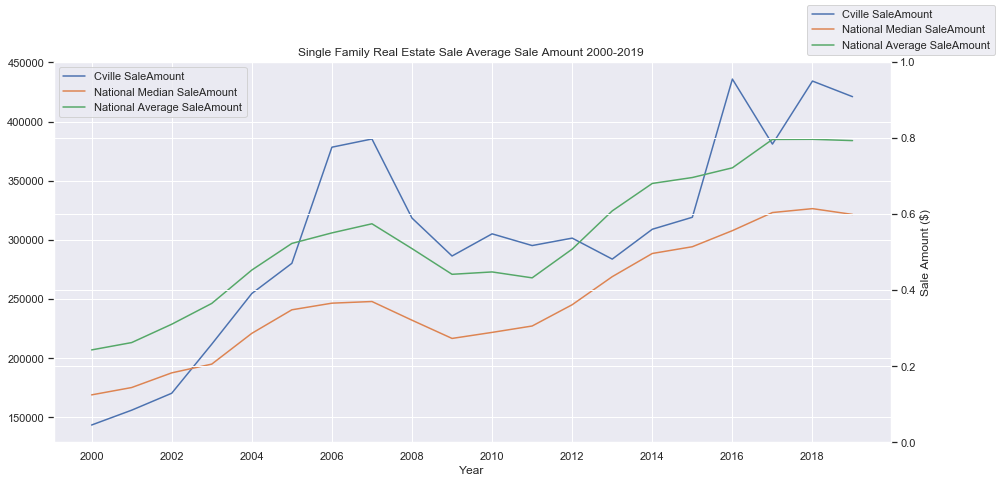

In [44]:
ax=sf20_trend.plot(x='Year', y ='Cville SaleAmount')
ax2=ax.twinx()
sf20_trend.plot(x='Year', y='National Median SaleAmount', ax=ax)
sf20_trend.plot(x='Year', y='National Average SaleAmount', ax=ax)
ax.figure.legend()
ax.set_xticks(np.arange(2000,2020,step=2))
plt.xticks(rotation=20)
plt.ylabel('Sale Amount ($)')
plt.title('Single Family Real Estate Sale Average Sale Amount 2000-2019 ')
plt.savefig('averages.png')
plt.show()
